In [1]:
from torch.utils import data as data
import pandas as pd
from torchvision.transforms.functional import normalize
from tqdm import tqdm
import os
from basicsr.data.data_util import (paired_paths_from_folder,
                                    paired_paths_from_lmdb,
                                    paired_paths_from_meta_info_file)
from basicsr.data.transforms import augment, paired_random_crop
from basicsr.utils import FileClient, imfrombytes, img2tensor, padding
from torch.utils.data.dataloader import default_collate
import h5py
# local modules
from basicsr.data.h5_augment import *

from torch.utils.data import ConcatDataset
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt


def transform_voxel(voxel, transpose_to_CHW=False, norm_voxel = True):
    """
    Augment voxel and turn into tensor
    @param voxel Input voxel
    @param seed  Seed for random number generation
    @returns Augmented voxel
    """

    if transpose_to_CHW:
        voxel = torch.from_numpy(voxel.transpose(2, 0, 1)).float()# H,W,C -> C,H,W

    else:
        if norm_voxel:
            voxel = torch.from_numpy(voxel).float() / abs(max(voxel.min(), voxel.max(), key=abs))  # -1 ~ 1
        else:
            voxel = torch.from_numpy(voxel).float()

    # if self.vox_transform:
    #     random.seed(seed)
    #     voxel = self.vox_transform(voxel)
    return voxel

/opt/conda/envs/deblur/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


[!!alt_cuda_corr is not compiled!!]


# Gopro GT event VS Gen event

In [2]:
data_path = '/workspace/data/GOPRO/train/'
h5_folder = os.listdir(data_path)
h5_folder.sort()
datasets = []

total_rmse = 0
reversed_total_rmse = 0
best_total_rmse = 0
cnt = 0

# for h5 in tqdm(h5_folder[0:], ncols=80):
#     imgs_path = os.path.join(data_path,h5)
#     h5_file = h5py.File(imgs_path,'r')

#     for tmp_idx in h5_file['gen_event'].keys():
#         idx = tmp_idx[5:]

#         event =h5_file['gen_event'][f'image{idx}'][:]
#         blur_img = h5_file['images'][f'image{idx}'][:]
#         sharp_img = h5_file['sharp_images'][f'image{idx}'][:]
#         voxel = h5_file['voxels'][f'voxel{idx}'][:]

#         # normalize voxel
#         voxel_max = np.max(np.abs(voxel))
#         voxel = voxel/voxel_max

#         event_max = np.max(np.abs(event))
#         event = event / event_max

#         voxel = (voxel + 1) / 2
#         event = (event+1)/2

#         diff = event - voxel
#         diff_power = diff ** 2
#         rmse = np.sqrt(np.mean(diff_power))

#         event =h5_file['gen_event'][f'image{idx}'][:]
#         event_max = np.max(np.abs(event))
#         event = event / event_max
#         event = (event+1)/2
#         event = event[::-1,:,:]
#         diff = event - voxel
#         diff_power = diff ** 2
#         reversed_rmse = np.sqrt(np.mean(diff_power))

#         total_rmse += rmse
#         reversed_total_rmse += reversed_rmse
#         best_total_rmse += min(rmse, reversed_rmse)

#         cnt += 1


# print(total_rmse/cnt)
# print(reversed_rmse/cnt)
# print(best_total_rmse/cnt)
        



In [2]:
data_path = '/workspace/data/GOPRO/train/'
h5_folder = os.listdir(data_path)
h5_folder.sort()
datasets = []

idx = '000000000'
for h5 in h5_folder[:]:
    imgs_path = os.path.join(data_path,h5)
    h5_file = h5py.File(imgs_path,'r')
    print(imgs_path)

    h5_file
    break

event =h5_file['gen_event'][f'image{idx}'][:]
blur_img = h5_file['images'][f'image{idx}'][:]
sharp_img = h5_file['sharp_images'][f'image{idx}'][:]
voxel = h5_file['voxels'][f'voxel{idx}'][:]

blur_img = blur_img.transpose(1,2,0)
sharp_img = sharp_img.transpose(1,2,0)


n_event = np.array(event)
voxel = np.array(voxel)



n_event = np.array(transform_voxel(n_event))
voxel = np.array(transform_voxel(voxel))

print(h5_file)

scene = 'GOPR0372_07_00'

gan_event = np.load(f'/workspace/Marigold/results/Gopro_Event_Train/{scene}/image000000/out.npy')
gan_event = gan_event.transpose(2,0,1)
gan_event = np.array(transform_voxel(gan_event))

cons_event = np.load(f'/workspace/data/B2E_results/cons/Gopro_Event_Train/{scene}/image000000/out.npy')
cons_event = cons_event.transpose(2,0,1)
cons_event = np.array(transform_voxel(cons_event))

l1_event = np.load(f'/workspace/data/B2E_results/B2E_L1/Gopro_Event_Train/{scene}/image000000/out.npy')
l1_event = l1_event.transpose(2,0,1)
l1_event = np.array(transform_voxel(l1_event))

/workspace/data/GOPRO/train/GOPR0372_07_00.h5
<HDF5 file "GOPR0372_07_00.h5" (mode r)>


GT array has 3708813 zero values.


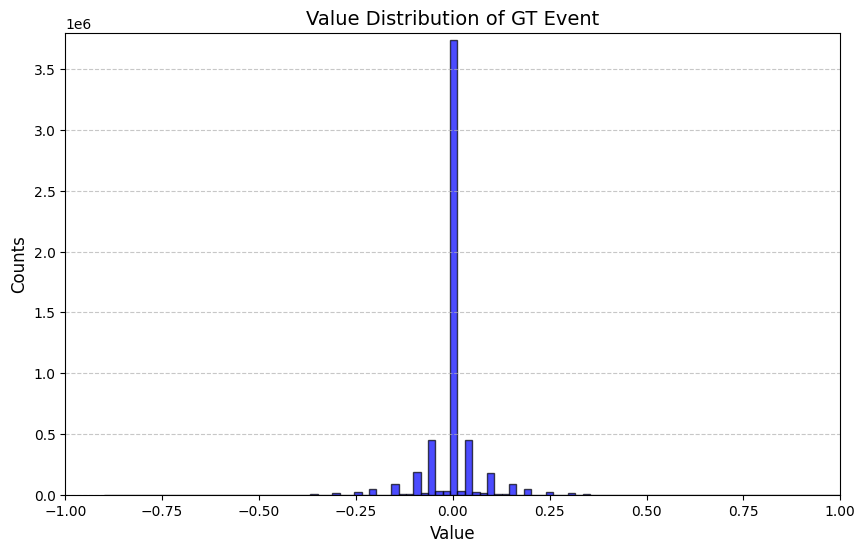

L2 array has 4023567 zero values.


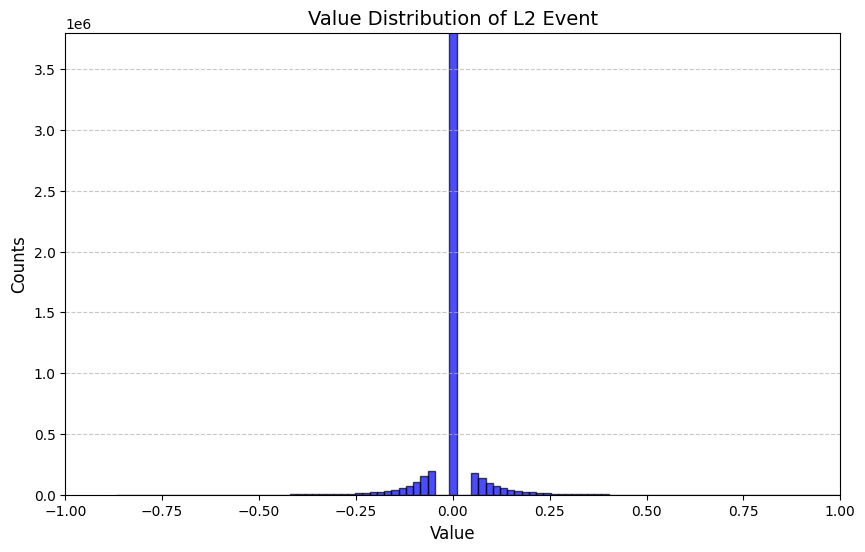

L1 array has 4019988 zero values.


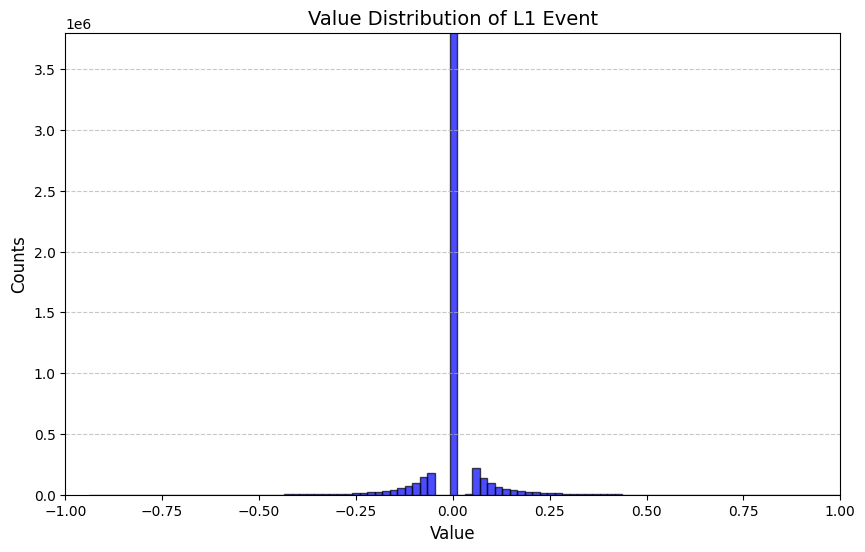

gan array has 4209211 zero values.


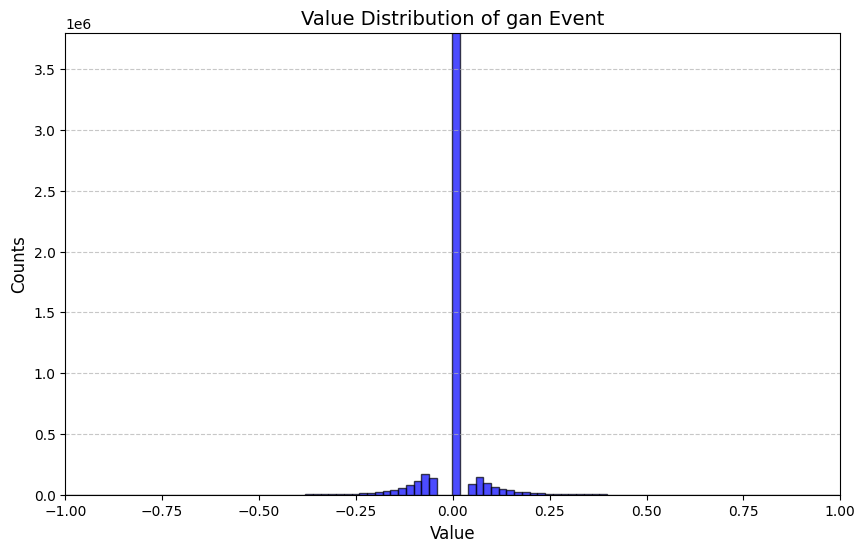

cons array has 4419082 zero values.


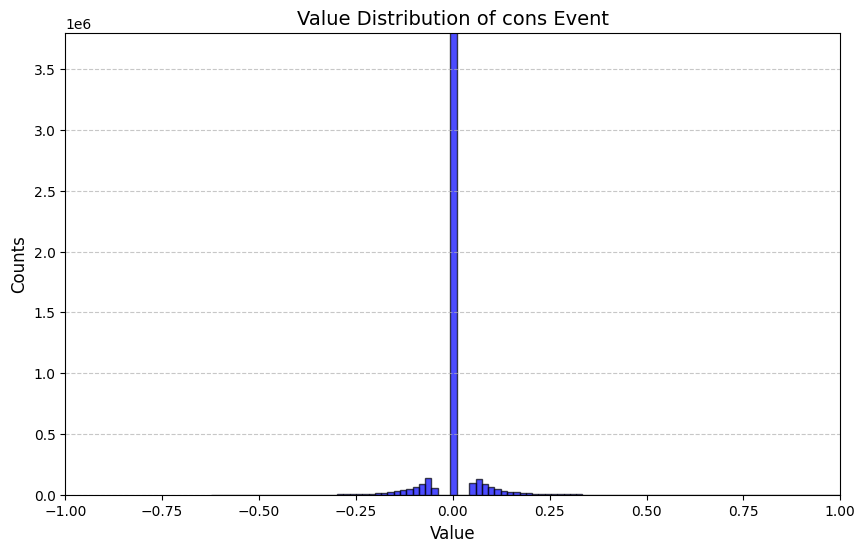

In [3]:
import numpy as np
import matplotlib.pyplot as plt

arrays = {'GT': voxel, 'L2': n_event, 'L1': l1_event, 'gan': gan_event, 'cons': cons_event}

# 각 배열의 0값 개수와 히스토그램 그리기
for name, array in arrays.items():
    # 데이터 1D로 변환
    flattened_data = array.flatten()
    if name != 'GT':
        flattened_data[np.abs(flattened_data) <= 0.05] = 0
    
    # 0값 개수 계산
    zero_count = np.sum(flattened_data == 0)
    print(f"{name} array has {zero_count} zero values.")
    
    # 히스토그램 그리기
    plt.figure(figsize=(10, 6))
    plt.hist(flattened_data, bins=100, color='blue', alpha=0.7, edgecolor='black')
    plt.title(f"Value Distribution of {name} Event", fontsize=14)
    plt.xlabel("Value", fontsize=12)
    plt.ylabel("Counts", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.ylim(0, 3800000)
    
    # x축 범위를 -1에서 1로 설정
    plt.xlim(-1, 1)

    plt.show()

GT array has 4919359 zero values.


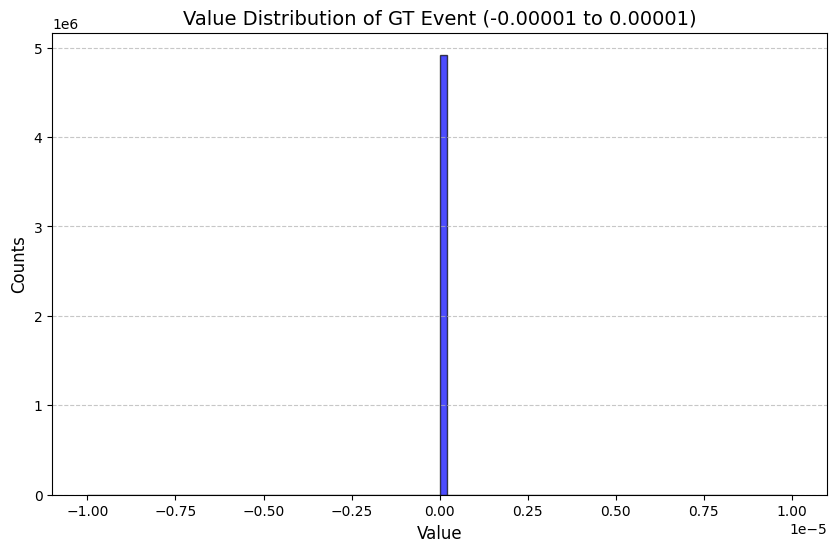

L2 array has 12 zero values.


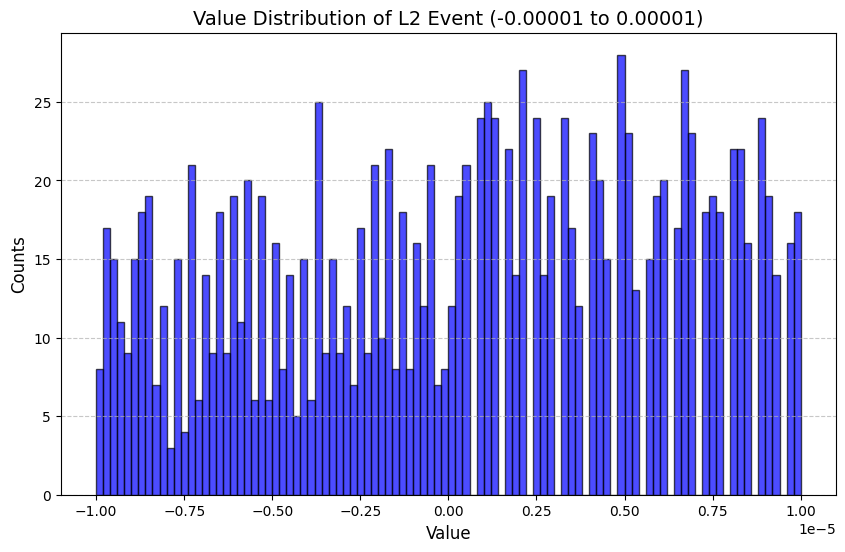

L1 array has 7 zero values.


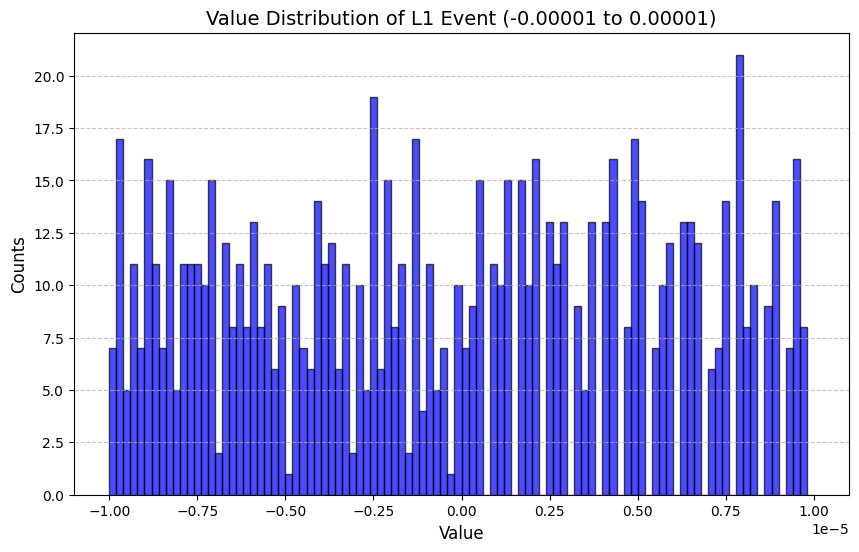

gan array has 17 zero values.


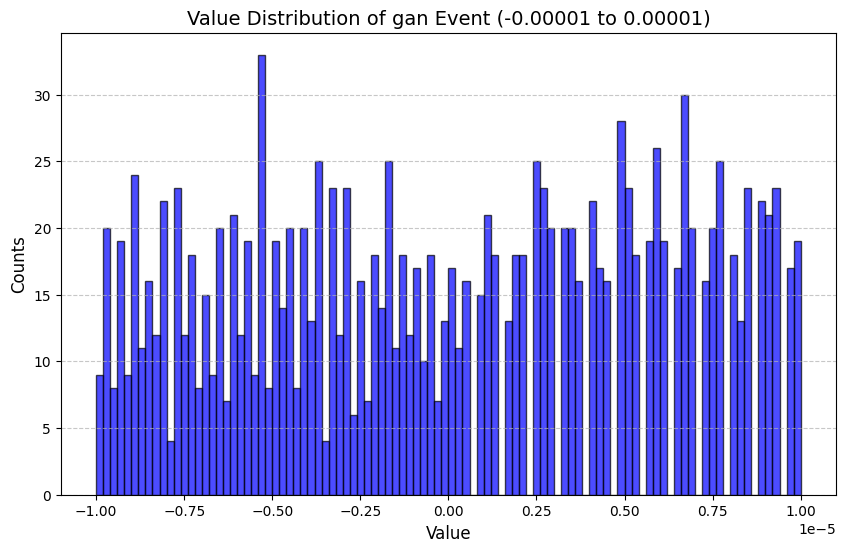

cons array has 15 zero values.


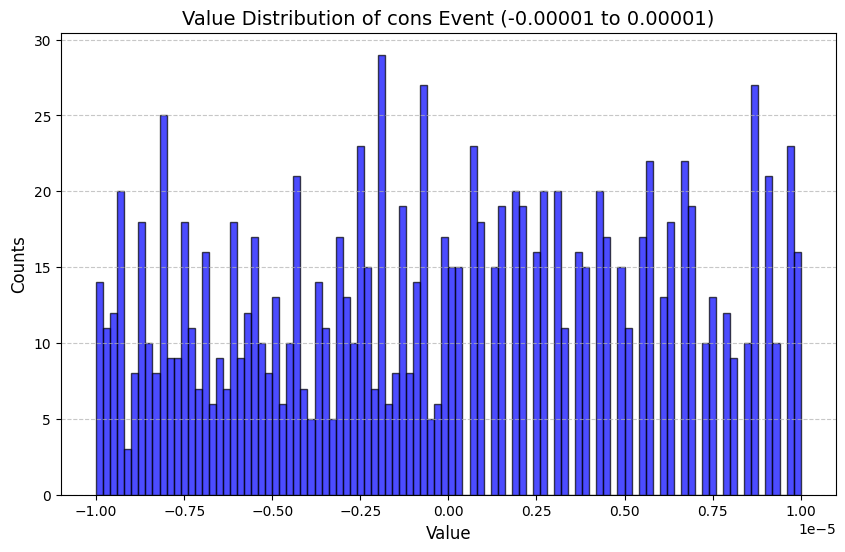

In [20]:
arrays = {'GT': voxel, 'L2': n_event, 'L1': l1_event, 'gan':gan_event, 'cons':cons_event}

# 각 배열의 0값 개수와 히스토그램 그리기
for name, array in arrays.items():
    # 데이터 1D로 변환
    flattened_data = array.flatten()
    
    # 0값 개수 계산
    zero_count = np.sum(flattened_data == 0)
    print(f"{name} array has {zero_count} zero values.")
    
    # 히스토그램 그리기 (x축 제한 설정)
    plt.figure(figsize=(10, 6))
    plt.hist(flattened_data, bins=100, color='blue', alpha=0.7, edgecolor='black', range=(-0.00001, 0.00001))
    plt.title(f"Value Distribution of {name} Event (-0.00001 to 0.00001)", fontsize=14)
    plt.xlabel("Value", fontsize=12)
    plt.ylabel("Counts", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

# vis polarity GoPro

13


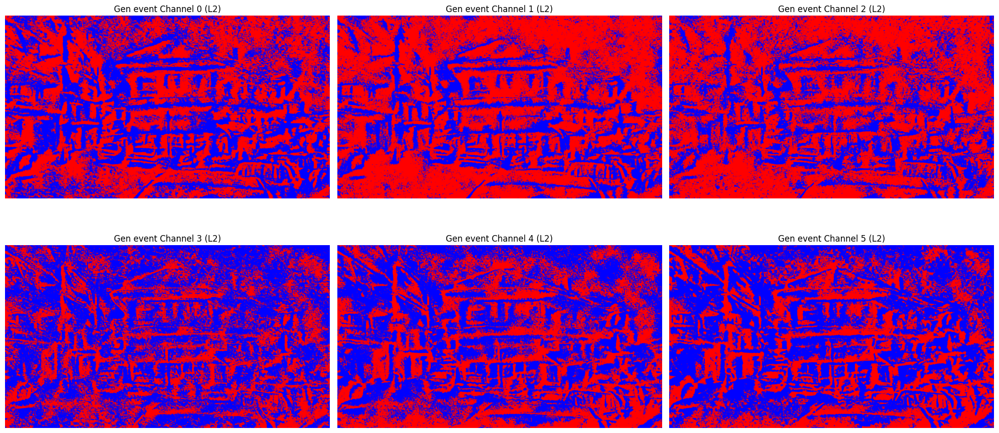

8


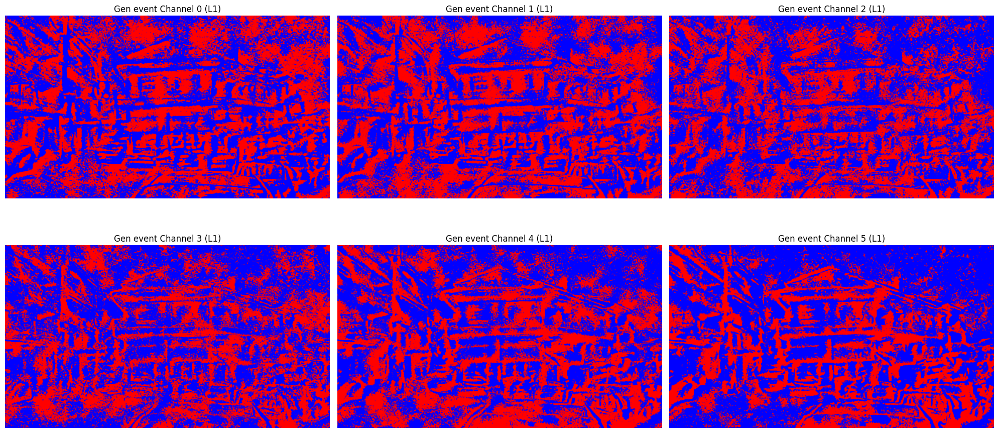

6


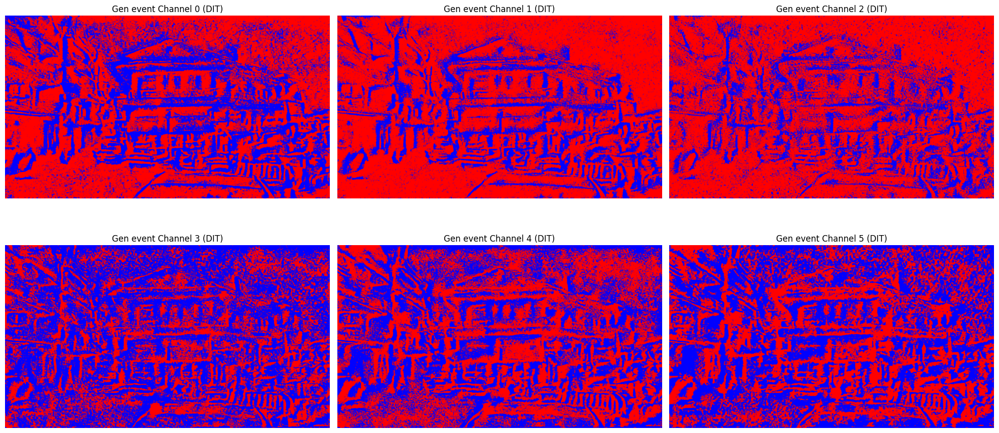

14


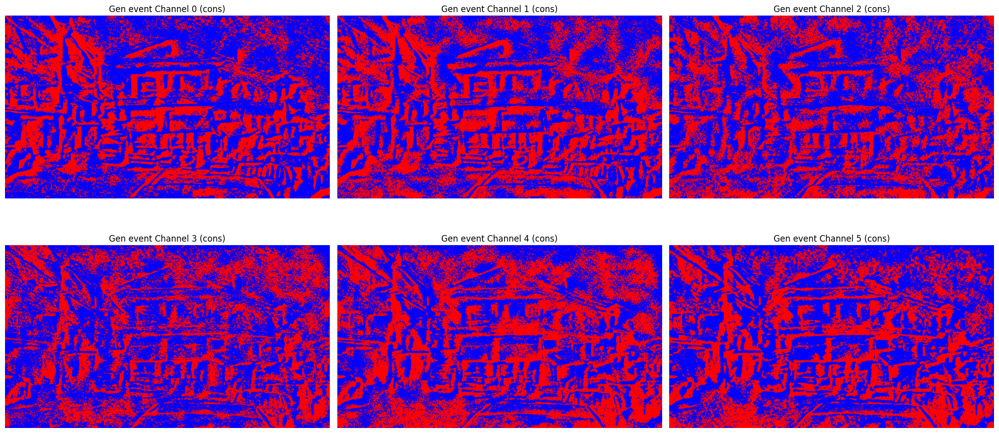

3708813


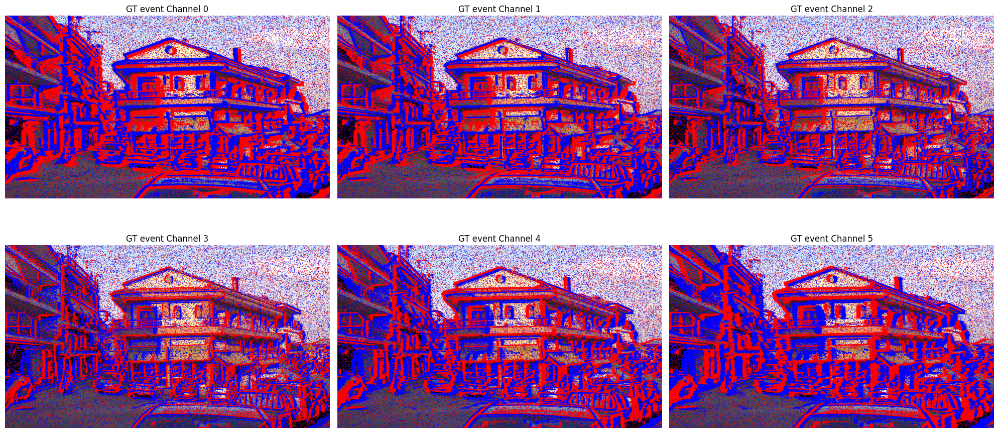

In [4]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# ------------------------------------
# (1) 데이터 준비
# ------------------------------------
#  efnet_event: (6, H, W) 형태 (채널 6개)
#  blur_img   : BGR 이미지 (배경)
efnet_event = n_event   # shape: (6, H, W)
bg_image    = blur_img  # BGR 이미지

threshold = 0

# 절대값이 threshold 이하인 값들을 0으로 설정
# efnet_event[np.abs(efnet_event) <= threshold] = 0

ours_zeros = np.sum(efnet_event==0)
print(ours_zeros)



fig, axs = plt.subplots(2, 3, figsize=(20, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, -1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c} (L2)")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

efnet_event = l1_event   # shape: (6, H, W)
bg_image    = blur_img  # BGR 이미지

ours_zeros = np.sum(efnet_event==0)
print(ours_zeros)


fig, axs = plt.subplots(2, 3, figsize=(20, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, -1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c} (L1)")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

efnet_event = gan_event   # shape: (6, H, W)
bg_image    = blur_img  # BGR 이미지

ours_zeros = np.sum(efnet_event==0)
print(ours_zeros)


fig, axs = plt.subplots(2, 3, figsize=(20, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, -1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c} (DIT)")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

efnet_event = cons_event   # shape: (6, H, W)
bg_image    = blur_img  # BGR 이미지

ours_zeros = np.sum(efnet_event==0)
print(ours_zeros)


fig, axs = plt.subplots(2, 3, figsize=(20, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, -1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c} (cons)")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()


efnet_event = voxel   # shape: (6, H, W)
bg_image    = blur_img  # BGR 이미지

ours_zeros = np.sum(efnet_event==0)
print(ours_zeros)

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(20, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, -1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"GT event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import cv2

plt.imshow(blur_img[:,:,::-1])
plt.show()

blur_img = cv2.imwrite('blur.png', blur_img)


# plit images in 2x3
plt.figure(figsize=(20, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    e = transform_voxel(event[i])
    e = np.array(e)
    e = np.abs(e)
    # e = (e + 1) / 2 
    e = e * 255
    e = e.astype(np.uint8)
    plt.imshow(e, cmap='gray')
    plt.title(f'Gen - Channel {i+1} (L2 loss)')
    plt.axis('off')

plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    e = transform_voxel(l1_event[i])
    e = np.array(e)
    e = np.abs(e)
    # e = (e + 1) / 2 
    e = e * 255
    e = e.astype(np.uint8)
    plt.imshow(e, cmap='gray')
    plt.title(f'Gen - Channel {i+1} (L1 loss)')
    plt.axis('off')

plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    e = transform_voxel(gan_event[i])
    e = np.array(e)
    e = np.abs(e)
    # e = (e + 1) / 2 
    e = e * 255
    e = e.astype(np.uint8)
    plt.imshow(e, cmap='gray')
    plt.title(f'Gen - Channel {i+1} (gan loss)')
    plt.axis('off')

plt.tight_layout()
plt.show()



plt.figure(figsize=(20, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    e = transform_voxel(cons_event[i])
    e = np.array(e)
    e = np.abs(e)
    # e = (e + 1) / 2 
    e = e * 255
    e = e.astype(np.uint8)
    plt.imshow(e, cmap='gray')
    plt.title(f'Gen - Channel {i+1} (cons loss)')
    plt.axis('off')

plt.tight_layout()
plt.show()


# plit images in 2x3
plt.figure(figsize=(20, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    e = transform_voxel(voxel[i])
    e = np.array(e)
    e = np.abs(e)
    # e = (e + 1) / 2 
    e = e * 255
    e = e.astype(np.uint8)
    plt.imshow(e, cmap='gray')
    plt.title(f'GT - Channel {i+1}')
    plt.axis('off')

plt.tight_layout()
plt.show()

# magnitude diff
plt.figure(figsize=(20, 8))

for i in range(6):
    plt.subplot(2, 3, i+1)
    
    # 1) transform_voxel로 [-1, 1] 범위의 데이터를 얻음
    gen_data = transform_voxel(event[i])   # shape: (H, W)
    gt_data  = transform_voxel(voxel[i])   # shape: (H, W)

    gen_data = np.array(gen_data)
    gt_data = np.array(gt_data)

    gen_data = np.abs(gen_data)
    gt_data = np.abs(gt_data)
    
    diff_data = gen_data - gt_data
    diff_data = np.abs(diff_data)

    # 4) 0~255 범위 이미지로 변환
    diff_data = diff_data * 255.0
    diff_data = diff_data.astype(np.uint8)

    # 5) plt.imshow로 표시 (cmap은 원하는 것으로 설정 가능)
    #    보통 차이 맵은 양/음차이가 구분될 수 있도록 'bwr' 등 컬러맵을 쓰기도 함
    plt.imshow(diff_data, cmap='gray')
    
    plt.title(f'Diff - Channel {i+1} (L2 loss gen - GT)')
    plt.axis('off')
plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 8))

for i in range(6):
    plt.subplot(2, 3, i+1)
    
    # 1) transform_voxel로 [-1, 1] 범위의 데이터를 얻음
    gen_data = transform_voxel(l1_event[i])   # shape: (H, W)
    gt_data  = transform_voxel(voxel[i])   # shape: (H, W)

    gen_data = np.array(gen_data)
    gt_data = np.array(gt_data)

    gen_data = np.abs(gen_data)
    gt_data = np.abs(gt_data)
    
    diff_data = gen_data - gt_data
    diff_data = np.abs(diff_data)

    # 4) 0~255 범위 이미지로 변환
    diff_data = diff_data * 255.0
    diff_data = diff_data.astype(np.uint8)

    # 5) plt.imshow로 표시 (cmap은 원하는 것으로 설정 가능)
    #    보통 차이 맵은 양/음차이가 구분될 수 있도록 'bwr' 등 컬러맵을 쓰기도 함
    plt.imshow(diff_data, cmap='gray')
    
    plt.title(f'Diff - Channel {i+1} (L1 loss gen - GT)')
    plt.axis('off')
plt.tight_layout()
plt.show()


plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 8))

for i in range(6):
    plt.subplot(2, 3, i+1)
    
    # 1) transform_voxel로 [-1, 1] 범위의 데이터를 얻음
    gen_data = transform_voxel(event[i])   # shape: (H, W)
    gt_data  = transform_voxel(voxel[i])   # shape: (H, W)

    gen_data = np.array(gen_data)
    gt_data = np.array(gt_data)

    # gen_data = np.abs(gen_data)
    # gt_data = np.abs(gt_data)
    
    # 3) 시각화를 위한 0~1 범위로 스케일링
    diff_data = gen_data - gt_data
    # diff_data = np.abs(diff_data)
    
    # # 4) 0~255 범위 이미지로 변환
    # diff_data = diff_data * 255.0
    # diff_data = diff_data.astype(np.uint8)

    # 5) plt.imshow로 표시 (cmap은 원하는 것으로 설정 가능)
    #    보통 차이 맵은 양/음차이가 구분될 수 있도록 'bwr' 등 컬러맵을 쓰기도 함
    plt.imshow(diff_data, cmap='bwr', vmin = -2, vmax = 2)
    
    plt.title(f'Diff Channel {i+1}')
    plt.axis('off')

plt.tight_layout()
plt.show()




# HIDE

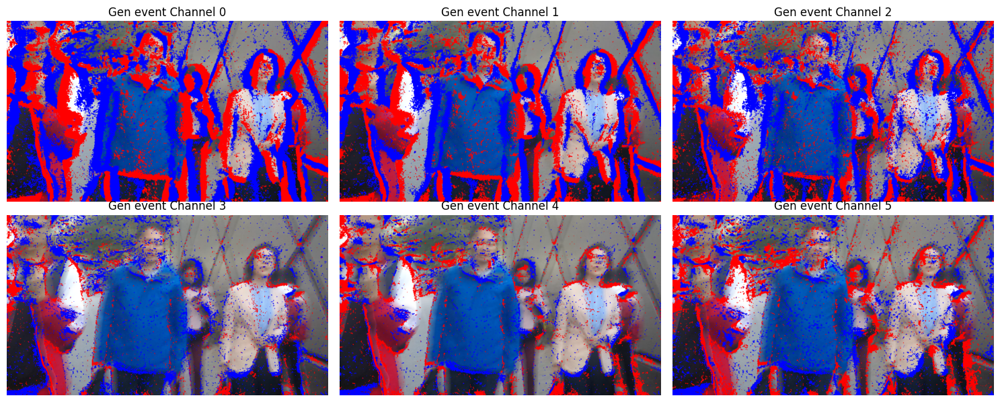

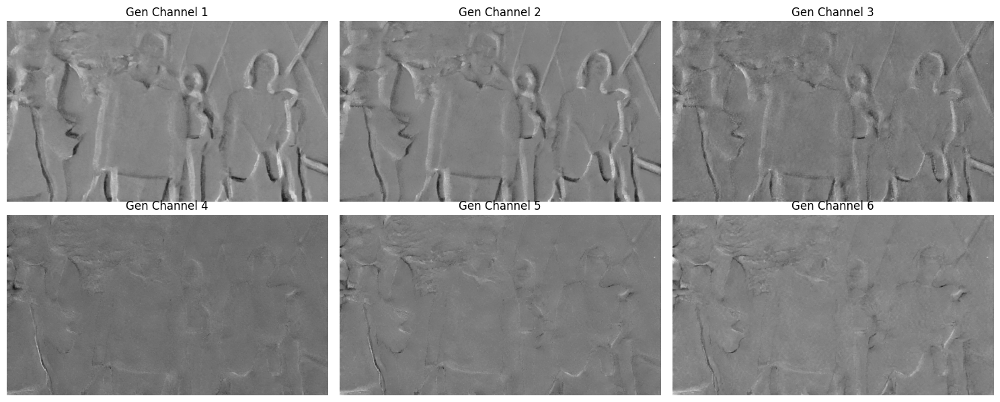

In [4]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import cv2

blur_path = '/workspace/data/HIDE_dataset/test/test-close-ups/106fromGOPR1087.MP4.png'
event_path = blur_path.replace('png', 'npy')
event = np.load(event_path)
max_val = np.max(np.abs(event))
event = event / max_val
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)

efnet_event = event
bg_image = blur_img  # BGR 이미지


# ##################

# efnet_event[-1] = -efnet_event[0]
# efnet_event[-2] = -efnet_event[1]
# efnet_event[-3] = -efnet_event[2]


###########


threshold = 0.05

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 6))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()


plt.figure(figsize=(15, 6))
for i in range(6):
    plt.subplot(2, 3, i+1)
    e = event[i]
    e = (e + 1) / 2 
    e = e * 255
    e = e.astype(np.uint8)
    plt.imshow(e, cmap='gray')
    plt.title(f'Gen Channel {i+1}')
    plt.axis('off')

plt.tight_layout()
plt.show()

(6, 720, 1280)

# RealBlur - J

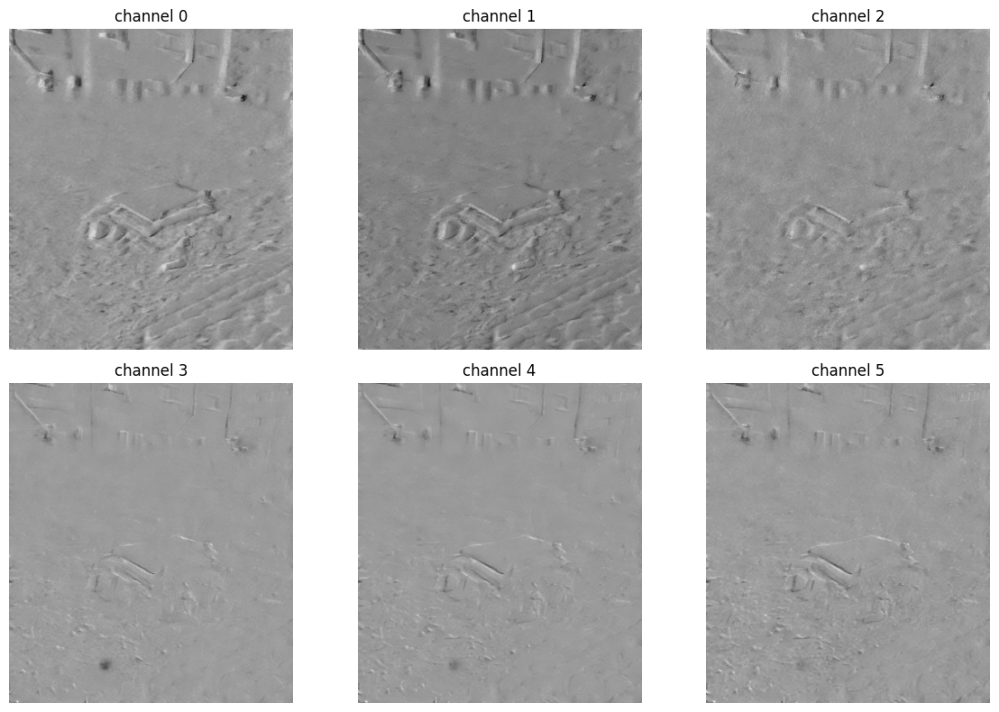

In [1]:
import os
import matplotlib.pyplot as plt

scene = 'scene206'
img_name = '5'

event_path = f'/workspace/Marigold/results/RealBlur-J/{scene}_blur_{img_name}.png'
imgs = os.listdir(event_path)
imgs.sort()

blur_img = imgs[-1]

plt.figure(figsize=(12, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    img = plt.imread(os.path.join(event_path, imgs[i]))
    plt.imshow(img, cmap='gray')
    plt.title(f'channel {i}')
    plt.axis('off')
plt.tight_layout()
plt.show()


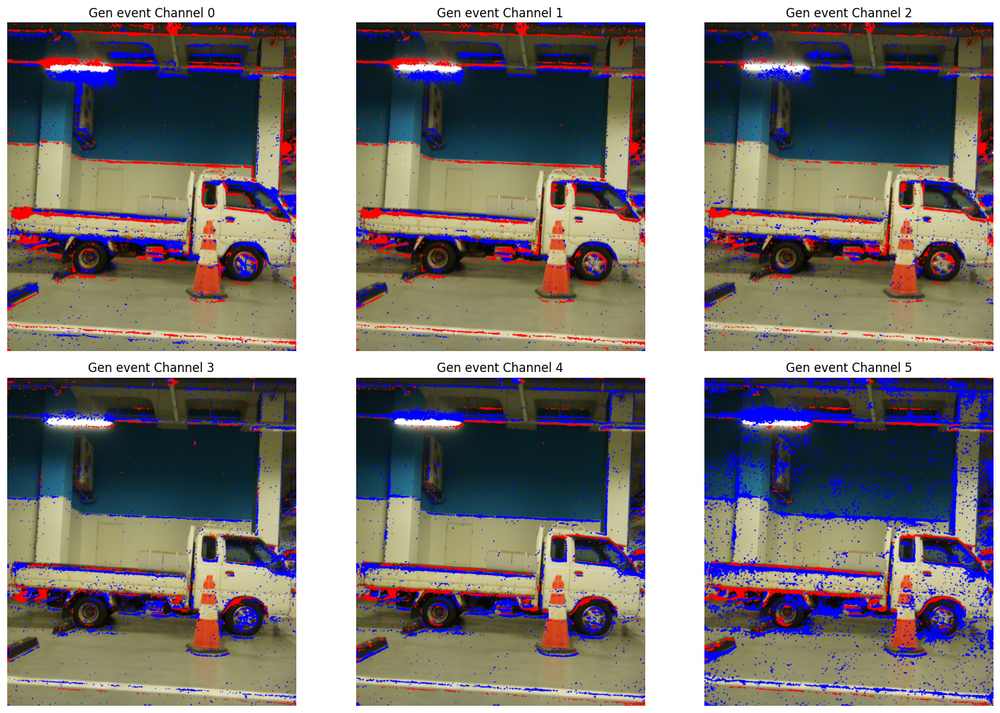

In [10]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

scene = 'scene017'
img_name = '19'
event_path = f'/workspace/data/RealBlur/RealBlur-J_ECC_IMCORR_centroid_itensity_ref/{scene}/event/event_{img_name}.npy'
blur_path = event_path.replace('event', 'blur')
blur_path = blur_path.replace('npy','png')
event = np.load(event_path)
event = event / 127.5 - 1
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)

efnet_event = event
bg_image = blur_img  # BGR 이미지

threshold = 0.08

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

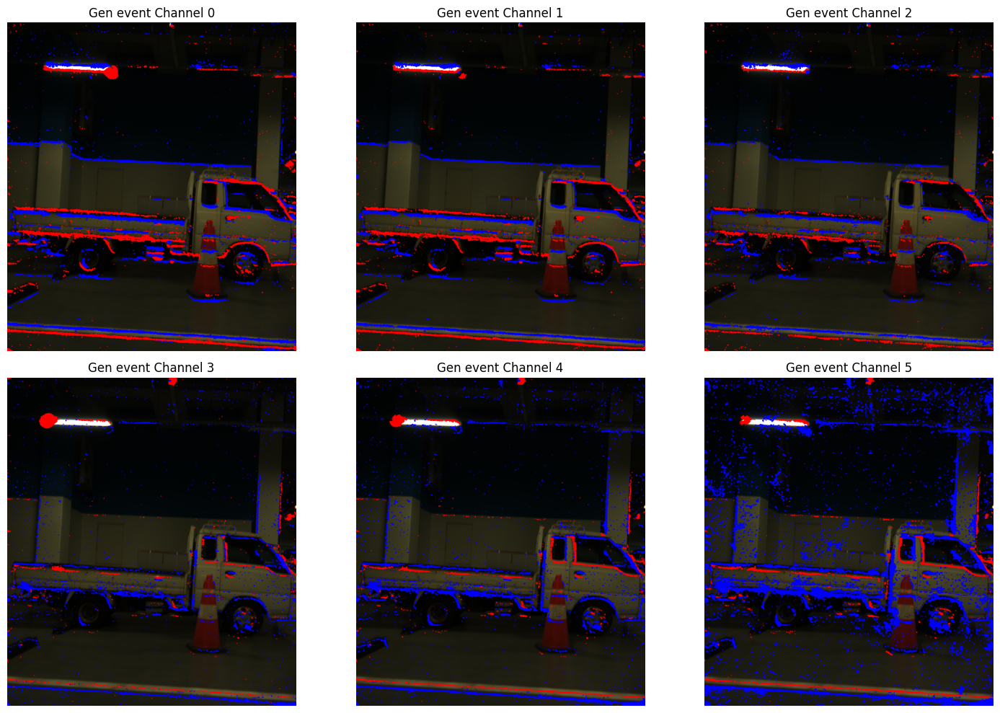

In [11]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

scene = 'scene017'
img_name = '19'
event_path = f'/workspace/data/RealBlur/RealBlur-R_BM3D_ECC_IMCORR_centroid_itensity_ref/{scene}/event/event_{img_name}.npy'
blur_path = event_path.replace('event', 'blur')
blur_path = blur_path.replace('npy','png')
event = np.load(event_path)
event = event / 127.5 - 1
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)

efnet_event = event
bg_image = blur_img  # BGR 이미지

threshold = 0.08

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# RealBlur - R

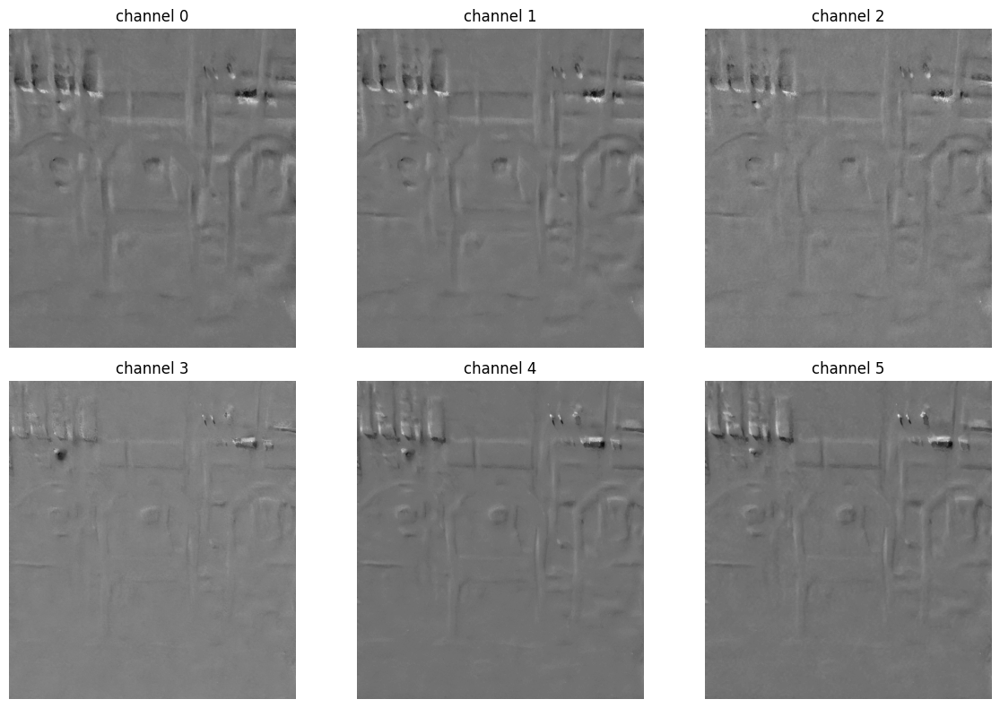

In [26]:
import os
import matplotlib.pyplot as plt

scene = 'scene149'
img_name = '6'

event_path = f'/workspace/Marigold/results/RealBlur-R/{scene}_blur_{img_name}.png'
imgs = os.listdir(event_path)
imgs.sort()

blur_img = imgs[-1]

plt.figure(figsize=(12, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    img = plt.imread(os.path.join(event_path, imgs[i]))
    plt.imshow(img, cmap='gray')
    plt.title(f'channel {i}')
    plt.axis('off')
plt.tight_layout()
plt.show()


# REDS

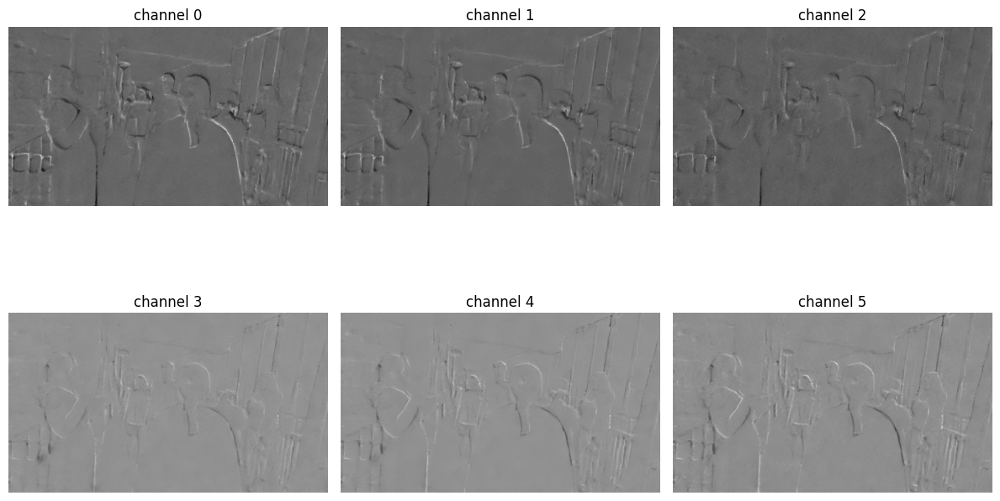

In [20]:
import os
import matplotlib.pyplot as plt

scene = '003'
img_name = '00000026'

event_path = f'/workspace/Marigold/results/REDS/{scene}_{img_name}'
imgs = os.listdir(event_path)
imgs.sort()


blur_img = imgs[-1]

plt.figure(figsize=(12, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    img = plt.imread(os.path.join(event_path, imgs[i]))
    plt.imshow(img, cmap='gray')
    plt.title(f'channel {i}')
    plt.axis('off')
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

scene = '0019'
img_name = '003139'

event_path = f'/workspace/data/RSBlur/{scene}/{img_name}/event/event.npy'
blur_path = event_path.replace('event', 'real_blur')
blur_path = blur_path.replace('npy','png')
event = np.load(event_path)
max_val = np.max(np.abs(event))
event = event / max_val
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)

efnet_event = event
bg_image = blur_img  # BGR 이미지

threshold = 0.08

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# RSblur

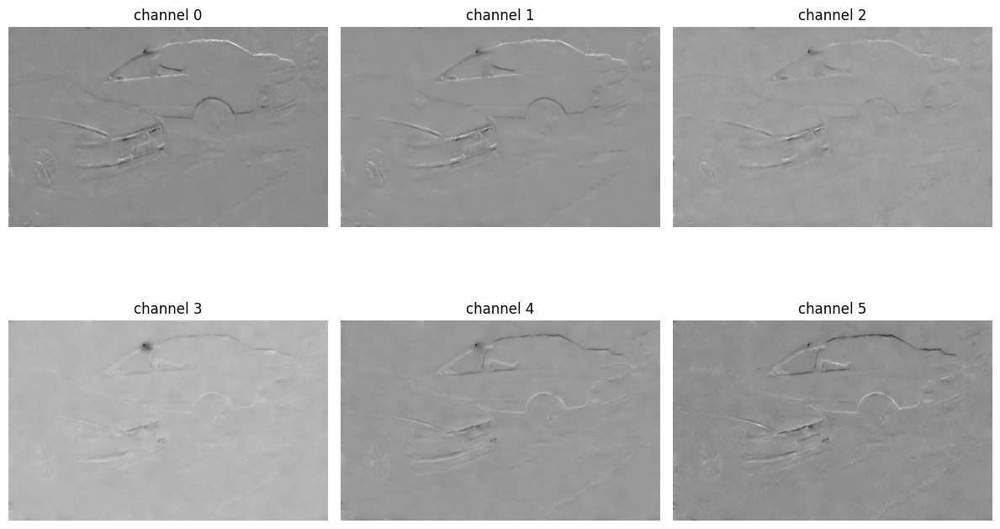

In [1]:
import os
import matplotlib.pyplot as plt

scene = '0019'
img_name = '003139'

event_path = f'/workspace/Marigold/results/RSblur/{scene}_{img_name}'
imgs = os.listdir(event_path)
imgs.sort()


blur_img = imgs[-1]

plt.figure(figsize=(12, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    img = plt.imread(os.path.join(event_path, imgs[i]))
    plt.imshow(img, cmap='gray')
    plt.title(f'channel {i}')
    plt.axis('off')
plt.tight_layout()
plt.show()


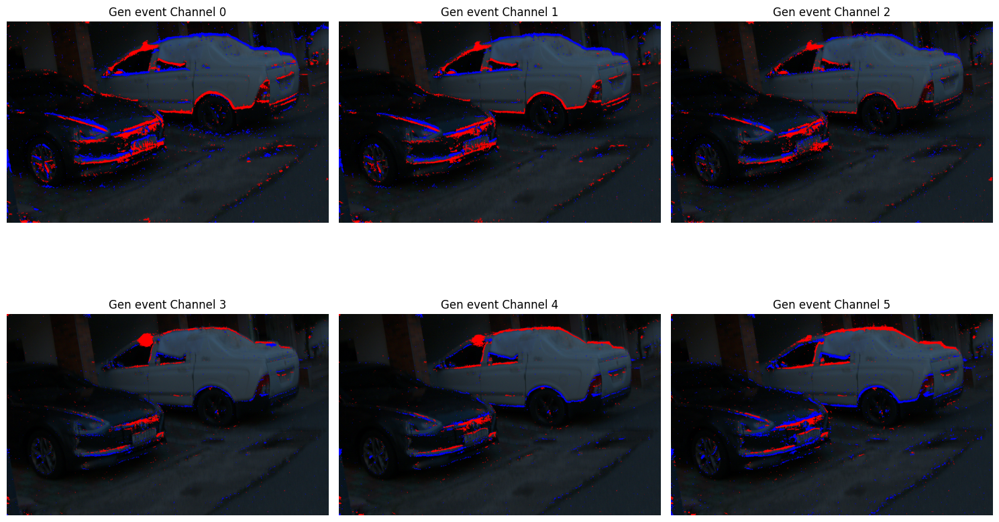

In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

scene = '0019'
img_name = '003139'

event_path = f'/workspace/data/RSBlur/{scene}/{img_name}/event/event.npy'
blur_path = event_path.replace('event', 'real_blur')
blur_path = blur_path.replace('npy','png')
event = np.load(event_path)
max_val = np.max(np.abs(event))
event = event / max_val
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)

efnet_event = event
bg_image = blur_img  # BGR 이미지

threshold = 0.08

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

# LOLBlur

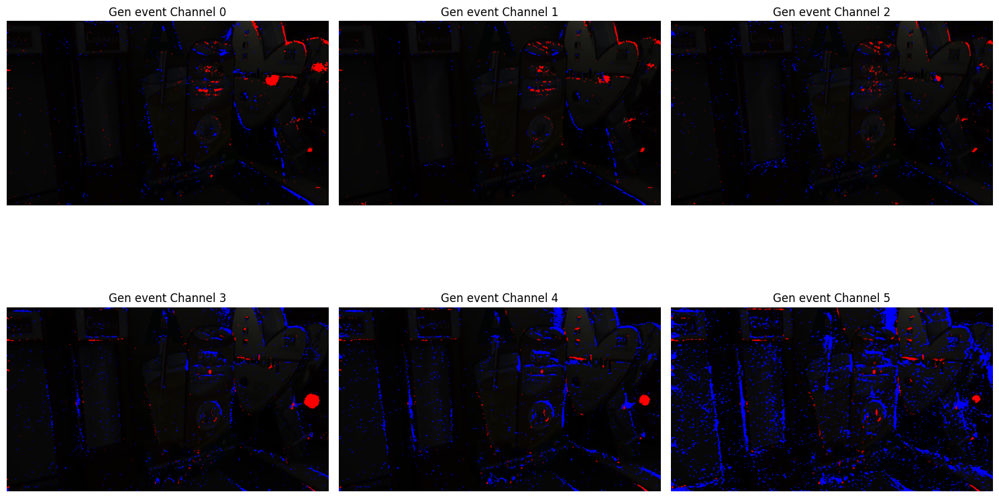

In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

scene = '0012'
img_name = '0011'
event_path = f'/workspace/data/LOLBlur/test/event/{scene}/{img_name}.npy'
blur_path = event_path.replace('event', 'low_blur')
blur_path = blur_path.replace('npy','png')
event = np.load(event_path)
max_val = np.max(np.abs(event))
event = event / max_val
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)
cv2.imwrite('blur1.png', blur_img)

efnet_event = event
bg_image = blur_img  # BGR 이미지

threshold = 0.08

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

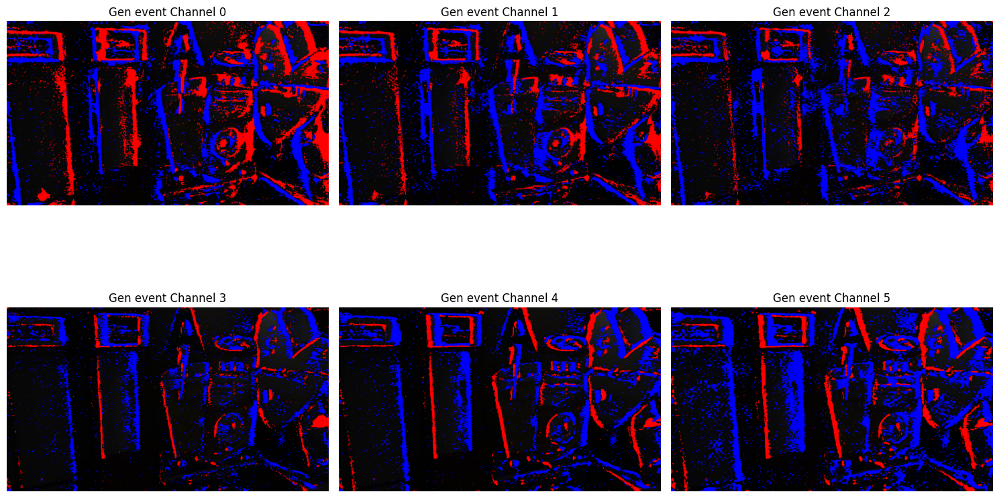

In [3]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

scene = '0012'
img_name = '0017'
event_path = f'/workspace/data/LOLBlur/test/event/{scene}/{img_name}.npy'
blur_path = event_path.replace('event', 'low_blur')
blur_path = blur_path.replace('npy','png')
event = np.load(event_path)
max_val = np.max(np.abs(event))
event = event / max_val
event = np.transpose(event,(2,0,1))

blur_img = cv2.imread(blur_path)
# blur_img = cv2.cvtColor(blur_img,cv2.COLOR_BGR2RGB)
cv2.imwrite('blur2.png', blur_img)

efnet_event = event
bg_image = blur_img  # BGR 이미지

threshold = 0.08

# ------------------------------------
# (2) 2x3 격자 서브플롯 생성
# ------------------------------------
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i, c in enumerate(range(6)):
    # (2-1) BGR → RGB 변환 (matplotlib 시각화용)
    overlay = cv2.cvtColor(bg_image, cv2.COLOR_BGR2RGB).copy()

    # (2-2) 해당 채널의 이벤트 데이터
    channel_data = efnet_event[c]  # shape: (H, W)

    # (2-3) 절댓값이 threshold 초과하는 픽셀 찾기
    ys, xs = np.where(np.abs(channel_data) > threshold)

    # (2-4) 빨강/파랑 점 그리기
    for (y, x) in zip(ys, xs):
        value = channel_data[y, x]
        if value > 0:
            color = (0, 0, 255)  # 빨강 (BGR)
        else:
            color = (255, 0, 0)  # 파랑 (BGR)
        cv2.circle(overlay, (x, y), 1, color, 1)

    # (2-5) subplot에 표시
    row = i // 3
    col = i % 3
    axs[row, col].imshow(overlay)
    axs[row, col].set_title(f"Gen event Channel {c}")
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()